# Final Project



### **Note:**
1. Please manually upload the image to the session storage on the left-hand side
2. All testing images are included in the submitted zip file

In [1]:
import sys 
import cv2 # imports OpenCV
import numpy as np
from pathlib import Path
from matplotlib import pyplot as plt #imports matplotlib
from scipy.ndimage import gaussian_filter
from lib.image_enhancement_pipeline import load_rgb_image, invert_and_gray, compute_local_std, compute_cci, compute_dark_channel, contrast_guided_atm_light, estimate_transmission, recover_radiance, run_full_pipeline
print('-'*100)
print ('Python version: {}'.format(sys.version))
print('OpenCV version: {}'.format(cv2.__version__))

----------------------------------------------------------------------------------------------------
Python version: 3.12.4 (v3.12.4:8e8a4baf65, Jun  6 2024, 17:33:18) [Clang 13.0.0 (clang-1300.0.29.30)]
OpenCV version: 4.12.0


## Plot Original Images

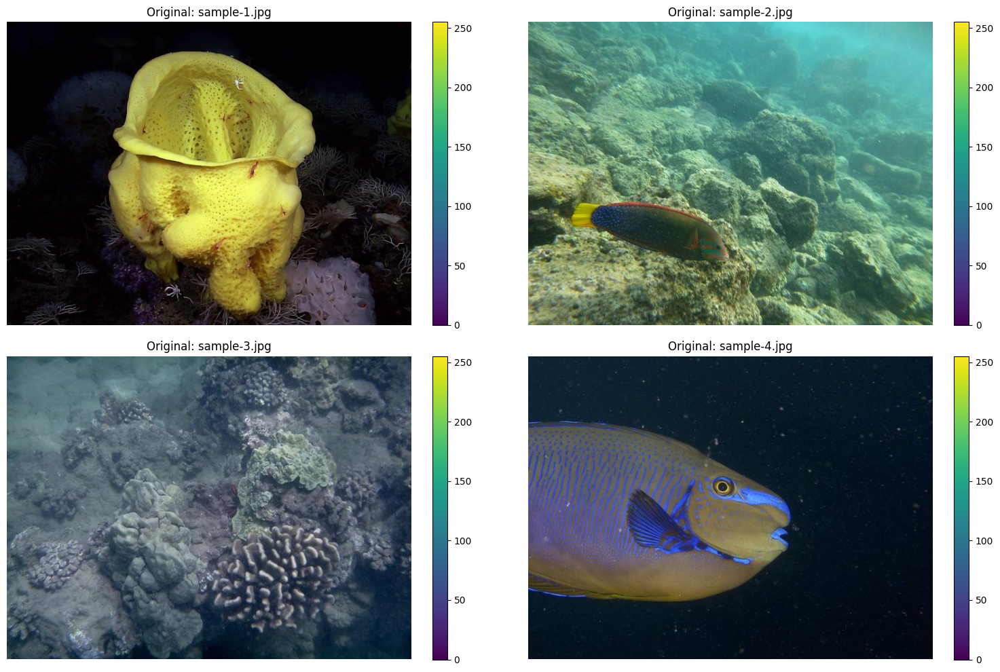

In [2]:
image_paths = [
    "./data/sample-1.jpg",
    "./data/sample-2.jpg",
    "./data/sample-3.jpg",
    "./data/sample-4.jpg"
]

# Display all 4 original images in one figure and store them
original_images = []

fig, axes = plt.subplots(2, 2, figsize=(16, 10))
for ax, path in zip(axes.ravel(), image_paths):
    img = load_rgb_image(path)
    original_images.append(img)
    im = ax.imshow(img)
    plt.colorbar(im, ax=ax, orientation="vertical", fraction=0.046, pad=0.04)
    ax.set_title(f"Original: {Path(path).name}")
    ax.axis('off')

plt.tight_layout()
plt.show()

## Image Inversion and Grayscale
* The inverted image is required before process the CCI
* Turn inverted image to grayscale in order to be used later

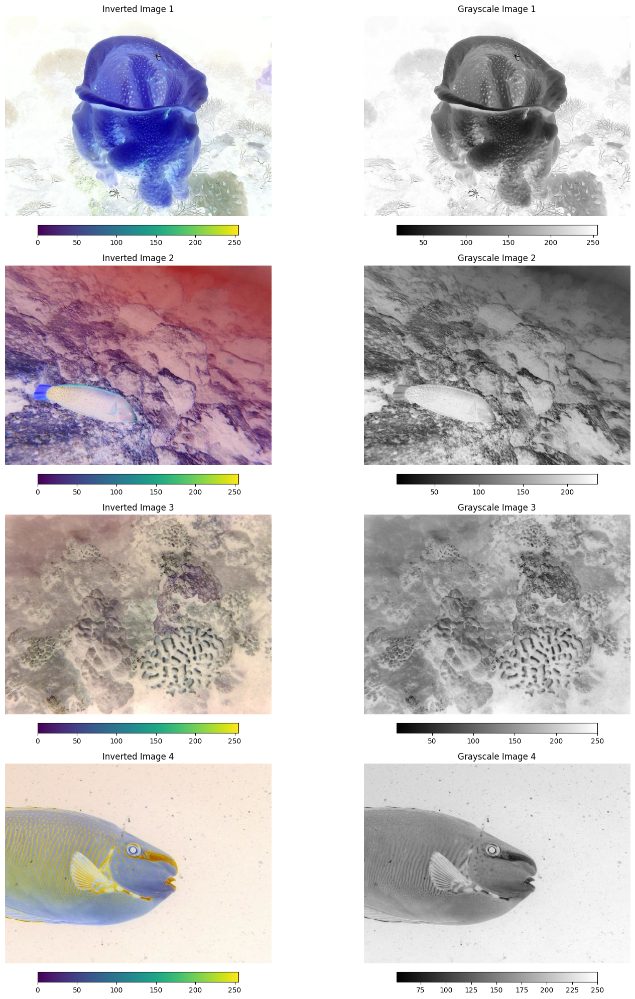

In [3]:
inverted_images = []
grayscale_images = []

for img in original_images:
    inverted, gray = invert_and_gray(img)
    inverted_images.append(inverted)
    grayscale_images.append(gray)

# Step 2: Prepare combined list and titles
combined_images = []
titles = []

for i in range(4):
    combined_images.append(inverted_images[i])
    titles.append(f"Inverted Image {i+1}")
    combined_images.append(grayscale_images[i])
    titles.append(f"Grayscale Image {i+1}")

# Step 3: Plot in 4×2 grid
fig, axes = plt.subplots(4, 2, figsize=(16, 20))

for ax, img, title in zip(axes.ravel(), combined_images, titles):
    im = ax.imshow(img, cmap='gray' if img.ndim == 2 else None)
    plt.colorbar(im, ax=ax, orientation="horizontal", fraction=0.046, pad=0.04)
    ax.set_title(title)
    ax.axis('off')

plt.tight_layout()
plt.show()

## Compute Local Std

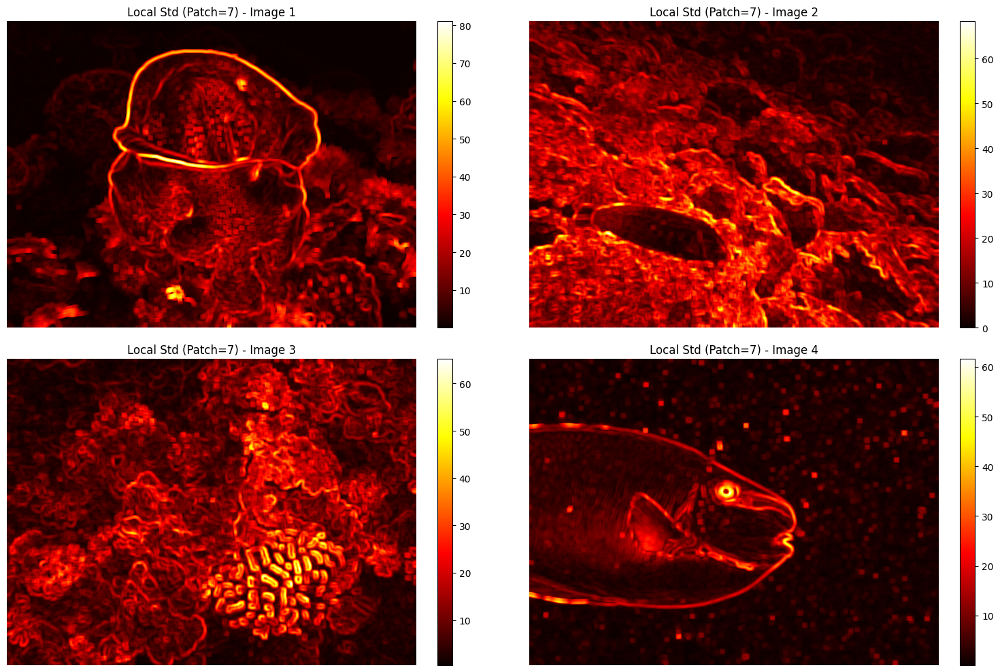

In [4]:
# Assume grayscale_images is already available from previous step
# and compute_local_std function is imported

local_std_scores = []  # store the 3D score stacks

# Compute local std deviation
for gray in grayscale_images:
    score = compute_local_std(gray, [15, 13, 11, 9, 7, 5, 3])
    local_std_scores.append(score)

# Visualization: Choose the 5th patch size (index 4, size=7)
fig, axes = plt.subplots(2, 2, figsize=(16, 10))
for i, ax in enumerate(axes.ravel()):
    score_map = local_std_scores[i][:, :, 4]  # slice for patch size 7
    im = ax.imshow(score_map, cmap='hot')
    plt.colorbar(im, ax=ax, orientation='vertical', fraction=0.046, pad=0.04)
    ax.set_title(f"Local Std (Patch=7) - Image {i+1}")
    ax.axis('off')

plt.tight_layout()
plt.show()

## Compute the Contrast Code Image (CCI)

The algorithm is based on the article "A Contrast-Guided Approach for the Enhancement of Low-Lighting Underwater Images" By Tunai Porto Marques, Alexandra Branzan Albu, and Maia Hoeberechts

* Needs to find local standard deviation with dynamic patch size
* Needs to consider the tolerance array according to the given tolerance value as 3

![CCI_Algorithm.png](./images/algo.png)

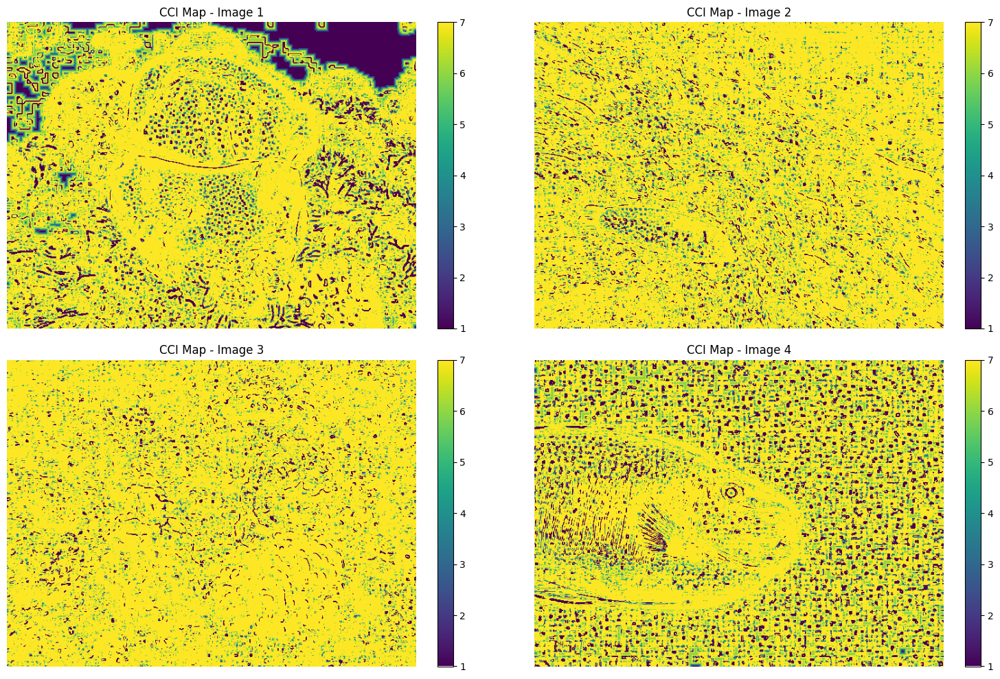

In [5]:
# Step 4: Compute CCI maps for all 4 grayscale images
CCI_maps = []

for score in local_std_scores:  # assuming score from compute_local_std
    CCI = compute_cci(score, tolerance=3)
    CCI_maps.append(CCI)

# Plot all 4 CCI maps
fig, axes = plt.subplots(2, 2, figsize=(16, 10))

for i, ax in enumerate(axes.ravel()):
    im = ax.imshow(CCI_maps[i], cmap='viridis')
    plt.colorbar(im, ax=ax, orientation='vertical', fraction=0.046, pad=0.04)
    ax.set_title(f"CCI Map - Image {i+1}")
    ax.axis('off')

plt.tight_layout()
plt.show()

## Compute dark channel

* Finding the min value for all channels
* Creating dark channel

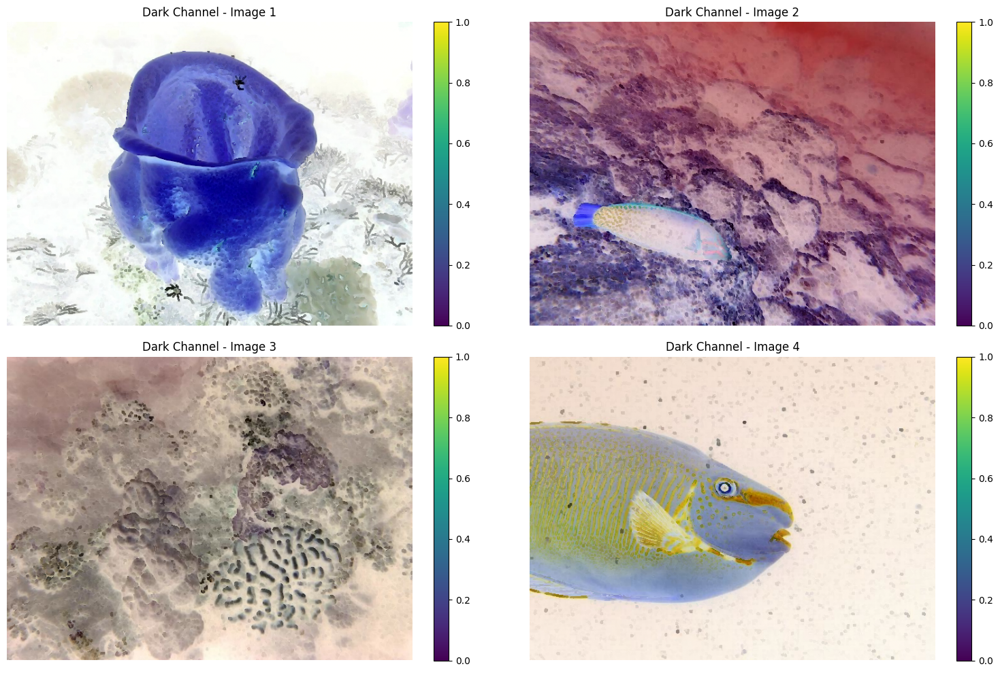

In [6]:
# Step 5: Compute Dark Channel for all 4 images
dark_channels = []

for i in range(4):
    dark = compute_dark_channel(inverted_images[i], CCI_maps[i])
    dark_channels.append(dark)

# Plot all 4 dark channel maps
fig, axes = plt.subplots(2, 2, figsize=(16, 10))

for i, ax in enumerate(axes.ravel()):
    im = ax.imshow(dark_channels[i] / 255.0)  # Normalize for visualization
    plt.colorbar(im, ax=ax, orientation='vertical', fraction=0.046, pad=0.04)
    ax.set_title(f"Dark Channel - Image {i+1}")
    ax.axis('off')

plt.tight_layout()
plt.show()

## Calculating Atm. Lighting Model

* Evaluating atm. lighting with two different patch sizes based on local contrast

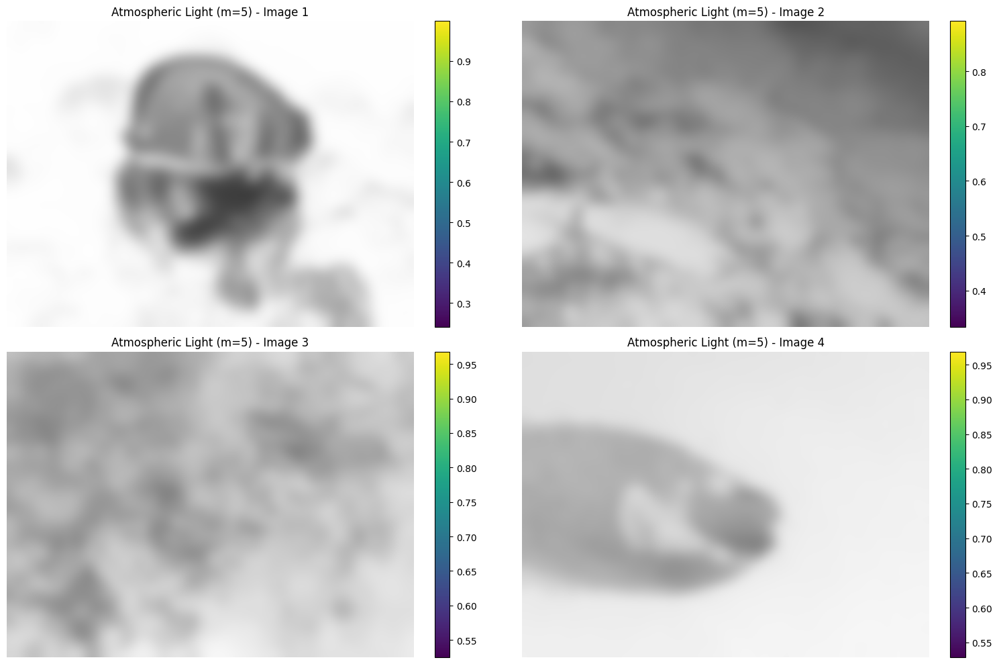

In [7]:
# Step 6: Compute Atmospheric Light (m=5) for all images
atm_light_list = []

for i in range(4):
    dark = dark_channels[i]
    CCI = CCI_maps[i]
    atm = np.stack([
        contrast_guided_atm_light(dark[:, :, c], CCI, multiplier=5)
        for c in range(3)
    ], axis=-1)
    atm_blurred = gaussian_filter(atm, sigma=10)
    atm_light_list.append(atm_blurred)

# Plot all 4 atmospheric light maps
fig, axes = plt.subplots(2, 2, figsize=(16, 10))

for i, ax in enumerate(axes.ravel()):
    im = ax.imshow(atm_light_list[i] / 255.0)  # Normalize for display
    plt.colorbar(im, ax=ax, orientation='vertical', fraction=0.046, pad=0.04)
    ax.set_title(f"Atmospheric Light (m=5) - Image {i+1}")
    ax.axis('off')

plt.tight_layout()
plt.show()

## Calculating the transmission map

* Evaluating atm. lighting with two different patch sizes based on local contrast
* Normalize the calculated atmospheric lighting model in each channel
* Ensure the normalized value is in the range between 0 - 1
* atm. lighting model will be pre-processed with gaussian filter and sigma is 10
* w = 0.9; r = 16; s = 4; eps = 0.45 is given

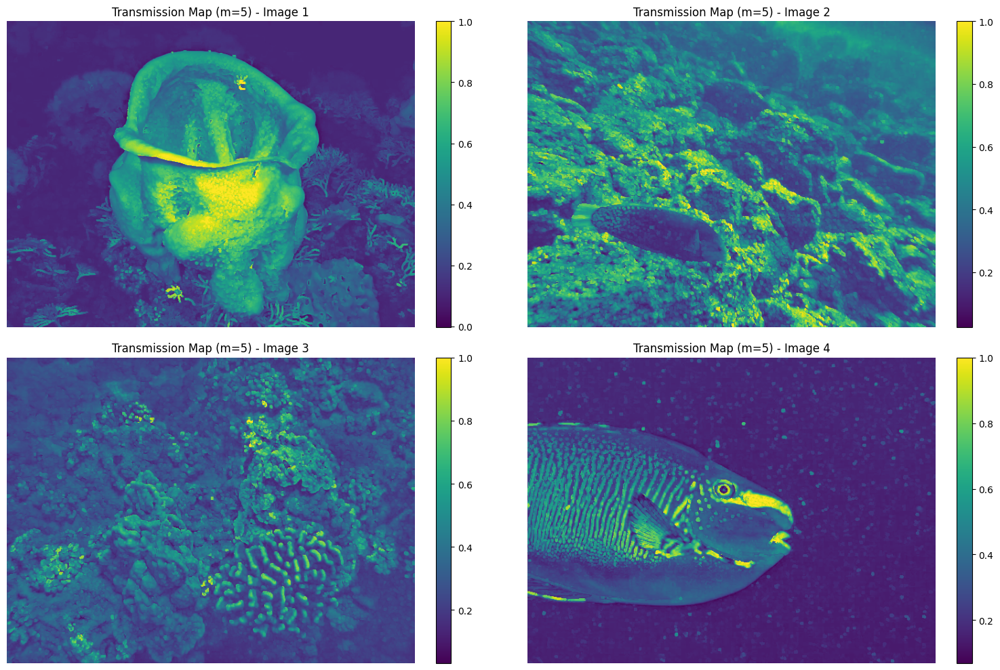

In [8]:
# Step 7: Compute Transmission Map (m=5) for all images
transmission_maps = []

for i in range(4):
    inverted = inverted_images[i]
    atm5 = atm_light_list[i]
    CCI = CCI_maps[i]
    trans = estimate_transmission(inverted, atm5, CCI)
    transmission_maps.append(trans)

# Plot all 4 transmission maps
fig, axes = plt.subplots(2, 2, figsize=(16, 10))

for i, ax in enumerate(axes.ravel()):
    im = ax.imshow(transmission_maps[i], cmap='viridis')
    plt.colorbar(im, ax=ax, orientation='vertical', fraction=0.046, pad=0.04)
    ax.set_title(f"Transmission Map (m=5) - Image {i+1}")
    ax.axis('off')

plt.tight_layout()
plt.show()

## Recovering the radiance(haze-less version of the image)

* loop throught the image to recover its radiance (haze-less version)
* subtract the original pixel value by the atm. light
* divide the result by the max of (tmap(x,y0 , t0))
* sum the result with the atm. light

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-7.008239..1.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-7.5381784..1.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.815983..1.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.3756409..1.0].


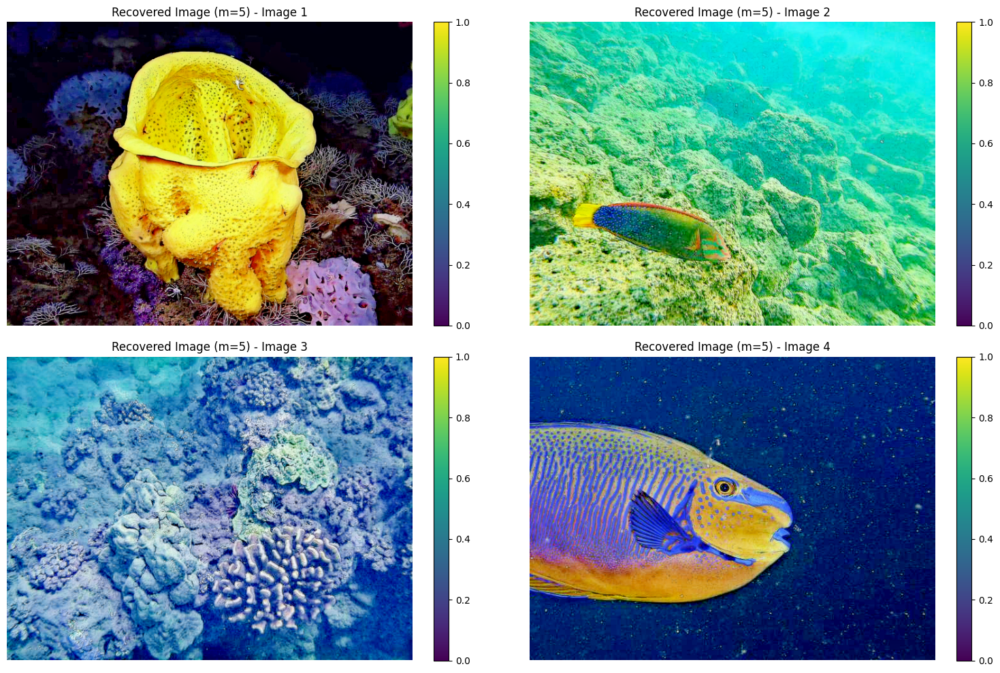

In [9]:
# Step 8: Recover Radiance for all images (m=5)
recovered_images = []

for i in range(4):
    inverted = inverted_images[i]
    atm5 = atm_light_list[i]
    trans5 = transmission_maps[i]
    recovered = recover_radiance(inverted, atm5, trans5)
    recovered_images.append(recovered)

# Plot all 4 recovered images
fig, axes = plt.subplots(2, 2, figsize=(16, 10))

for i, ax in enumerate(axes.ravel()):
    im = ax.imshow(recovered_images[i])
    plt.colorbar(im, ax=ax, orientation='vertical', fraction=0.046, pad=0.04)
    ax.set_title(f"Recovered Image (m=5) - Image {i+1}")
    ax.axis('off')

plt.tight_layout()
plt.show()

## Plot Original V.S. Processed Images

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-7.008239..1.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-7.5381784..1.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.815983..1.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.3756409..1.0].


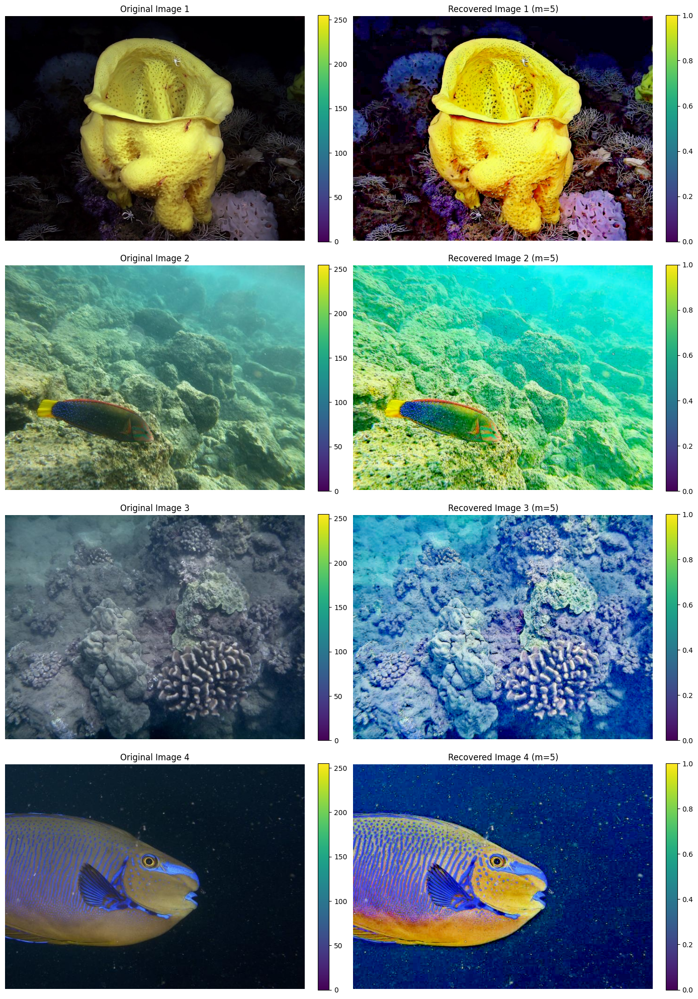

In [10]:
# 4×2 grid: left = original, right = processed
fig, axes = plt.subplots(4, 2, figsize=(14, 20))

for i in range(4):
    # Left: Original
    ax_orig = axes[i, 0]
    im1 = ax_orig.imshow(original_images[i])
    ax_orig.set_title(f"Original Image {i+1}")
    ax_orig.axis('off')
    plt.colorbar(im1, ax=ax_orig, orientation='vertical', fraction=0.046, pad=0.04)

    # Right: Recovered
    ax_proc = axes[i, 1]
    im2 = ax_proc.imshow(recovered_images[i])
    ax_proc.set_title(f"Recovered Image {i+1} (m=5)")
    ax_proc.axis('off')
    plt.colorbar(im2, ax=ax_proc, orientation='vertical', fraction=0.046, pad=0.04)

plt.tight_layout()
plt.show()

## Full Automating Pipeline

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-7.008239..1.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-7.5381784..1.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.815983..1.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.3756409..1.0].


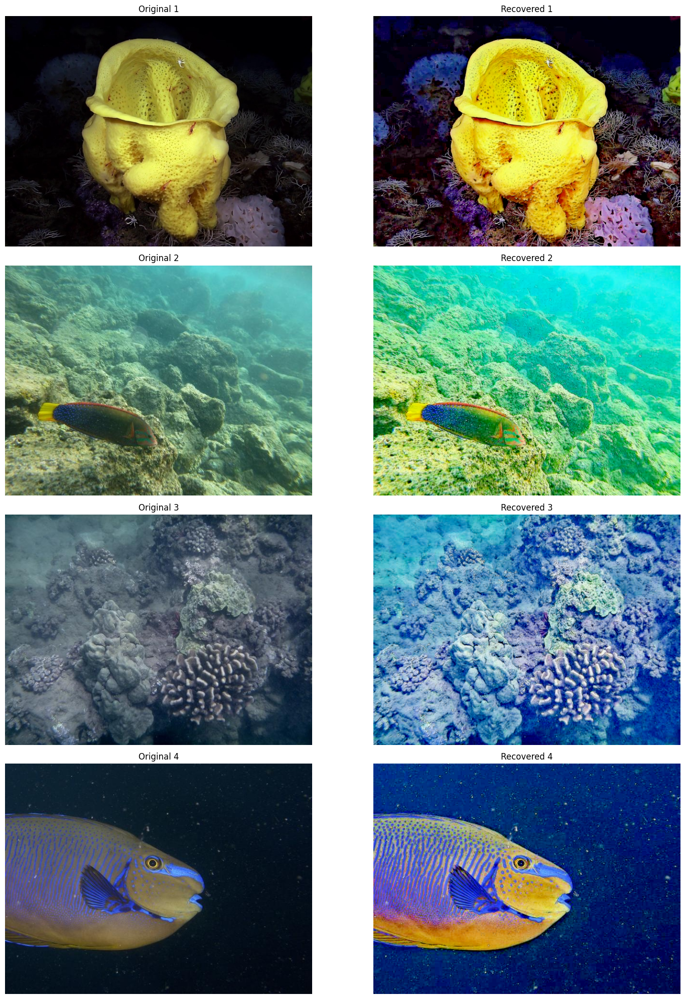

In [11]:
image_paths = [
        "./data/sample-1.jpg",
        "./data/sample-2.jpg",
        "./data/sample-3.jpg",
        "./data/sample-4.jpg"
    ]

original_images = [load_rgb_image(path) for path in image_paths]
recovered_images = [run_full_pipeline(img) for img in original_images]

fig, axes = plt.subplots(4, 2, figsize=(16, 20))
for i in range(4):
    axes[i, 0].imshow(original_images[i])
    axes[i, 0].set_title(f"Original {i+1}")
    axes[i, 0].axis('off')

    axes[i, 1].imshow(recovered_images[i])
    axes[i, 1].set_title(f"Recovered {i+1}")
    axes[i, 1].axis('off')

plt.tight_layout()
plt.show()